<a href="https://colab.research.google.com/github/Anantbir-S/AER850/blob/main/Untitleed8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
torch.cuda.empty_cache()

# Make sure Drive is mounted
from google.colab import drive
drive.mount('/content/drive')

!pip install ultralytics
from ultralytics import YOLO
import os

# Mount Google Drive (if not already mounted)
from google.colab import drive
drive.mount('/content/drive')

# Define dataset paths
dataset_path = "/content/drive/MyDrive/Project 3 Data"
train_images = os.path.join(dataset_path, "train/images")
val_images = os.path.join(dataset_path, "valid/images")
data_yaml = os.path.join(dataset_path, "data.yaml")
test_images_path = os.path.join(dataset_path, "test/images")

# Check dataset paths
print(f"Train Images Path Exists: {os.path.exists(train_images)}")
print(f"Validation Images Path Exists: {os.path.exists(val_images)}")
print(f"data.yaml Path Exists: {os.path.exists(data_yaml)}")
print(f"Test Images Path Exists: {os.path.exists(test_images_path)}")

# Navigate to dataset directory
%cd {dataset_path}

# Load YOLOv8 Nano model
model = YOLO('yolov8n.pt')  # YOLOv8 Nano (lightweight model)

# Train the model with simpler settings
model.train(
    data='data.yaml',
    epochs=150,         # Keep moderate epochs
    batch=8,           # Adjust batch size if needed
    imgsz=1024,         # Reduce image size if needed
    name='pcb_detector_optimized_Final',  # Descriptive model name
    amp=True
)

# Validate the model
metrics = model.val()
print(metrics)  # Outputs metrics like mAP50, mAP95, Precision, and Recall

# Predict on test images
results = model.predict(
    source=test_images_path,
    save=True  # Save predictions to runs/predict
)

# Notify where the predictions are saved
print(f"Predictions saved at: {os.path.join(dataset_path, 'runs/predict')}")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Train Images Path Exists: True
Validation Images Path Exists: True
data.yaml Path Exists: True
Test Images Path Exists: True
/content/drive/MyDrive/Project 3 Data
Ultralytics 8.3.49 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=data.yaml, epochs=150, time=None, patience=100, batch=8, imgsz=1024, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=pcb_detector_optimized_Final6, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=

train: Scanning /content/drive/MyDrive/Project 3 Data/train/labels.cache... 544 images, 0 backgrounds, 0 corrupt: 100%|██████████| 544/544 [00:00<?, ?it/s]

WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 26, len(boxes) = 108783. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/Project 3 Data/valid/labels.cache... 105 images, 0 backgrounds, 0 corrupt: 100%|██████████| 105/105 [00:00<?, ?it/s]

WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 26, len(boxes) = 19108. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


Plotting labels to runs/detect/pcb_detector_optimized_Final6/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000588, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 1024 train, 1024 val
Using 8 dataloader workers
Logging results to runs/detect/pcb_detector_optimized_Final6
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/150      13.4G      2.203      4.174      1.264       2433       1024: 100%|██████████| 68/68 [00:27<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:03<00:01,  1.98it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:54<00:00,  7.82s/it]

                   all        105      19108       0.76     0.0609     0.0579     0.0317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/150      13.1G       2.26      3.072      1.123       2540       1024: 100%|██████████| 68/68 [00:25<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:00,  2.22it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.64s/it]

                   all        105      19108      0.634     0.0933     0.0794     0.0443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/150        14G      2.178      2.575      1.093       3047       1024: 100%|██████████| 68/68 [00:25<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:00,  2.02it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.68s/it]

                   all        105      19108      0.525      0.133     0.0976     0.0532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/150      14.9G      2.142      2.301      1.088       2993       1024: 100%|██████████| 68/68 [00:25<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.74it/s]

                   all        105      19108      0.612      0.149      0.143     0.0796



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/150      14.2G      2.044      2.112      1.069       3936       1024: 100%|██████████| 68/68 [00:25<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.55it/s]

                   all        105      19108      0.605      0.181      0.151     0.0868



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/150      15.6G      1.975      1.968       1.06       2381       1024: 100%|██████████| 68/68 [00:25<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:01,  1.90it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.67s/it]

                   all        105      19108       0.54      0.198      0.166     0.0961



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/150      12.6G      1.937      1.888      1.049       2522       1024: 100%|██████████| 68/68 [00:25<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:01,  1.88it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:54<00:00,  7.72s/it]

                   all        105      19108      0.535      0.262      0.209       0.13



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/150      12.1G      1.961      1.842      1.039       2475       1024: 100%|██████████| 68/68 [00:26<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:03<00:01,  1.16it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:55<00:00,  7.98s/it]

                   all        105      19108      0.565      0.271      0.229      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/150      15.3G      1.912      1.786       1.04       3068       1024: 100%|██████████| 68/68 [00:25<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:03<00:01,  1.36it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:55<00:00,  7.88s/it]

                   all        105      19108      0.621      0.278      0.261       0.17



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/150        13G      1.932      1.779      1.044       2806       1024: 100%|██████████| 68/68 [00:25<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.65it/s]

                   all        105      19108      0.628      0.278      0.285       0.19



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/150      13.4G      1.886      1.718      1.022       2496       1024: 100%|██████████| 68/68 [00:26<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:01,  1.56it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:54<00:00,  7.78s/it]

                   all        105      19108      0.655      0.304      0.316      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/150      15.1G      1.882      1.687      1.029       1643       1024: 100%|██████████| 68/68 [00:25<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:01,  1.69it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:54<00:00,  7.72s/it]

                   all        105      19108      0.663        0.3      0.321      0.212



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/150      12.6G      1.838      1.647      1.016       2239       1024: 100%|██████████| 68/68 [00:25<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.73it/s]

                   all        105      19108      0.483      0.344      0.332      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/150      15.6G      1.841      1.616      1.016       2442       1024: 100%|██████████| 68/68 [00:24<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.52it/s]

                   all        105      19108      0.499       0.32       0.34       0.23



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/150      14.3G      1.845      1.596      1.012       2199       1024: 100%|██████████| 68/68 [00:25<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:01,  1.84it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.67s/it]

                   all        105      19108      0.634      0.332      0.352      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/150      14.6G      1.806      1.545      1.008       1862       1024: 100%|██████████| 68/68 [00:25<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:01,  1.75it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:54<00:00,  7.75s/it]

                   all        105      19108      0.563      0.373      0.385       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/150      11.4G       1.78      1.544      1.008       3450       1024: 100%|██████████| 68/68 [00:25<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.64it/s]

                   all        105      19108      0.575      0.377      0.388      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/150      13.5G      1.742      1.505     0.9992       2045       1024: 100%|██████████| 68/68 [00:24<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.83it/s]

                   all        105      19108      0.557      0.338      0.388      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/150        14G      1.775      1.487     0.9928       2405       1024: 100%|██████████| 68/68 [00:25<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:01,  1.89it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.62s/it]

                   all        105      19108      0.505      0.399      0.419      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/150      11.6G      1.744      1.468      0.993       3346       1024: 100%|██████████| 68/68 [00:24<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.85it/s]

                   all        105      19108      0.475       0.43      0.436        0.3



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/150      13.8G      1.743      1.444     0.9961       2783       1024: 100%|██████████| 68/68 [00:24<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:01,  1.64it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:54<00:00,  7.72s/it]

                   all        105      19108      0.557      0.415      0.425      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/150      12.5G      1.726      1.427     0.9856       2477       1024: 100%|██████████| 68/68 [00:26<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:01,  1.96it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.62s/it]

                   all        105      19108       0.58      0.398       0.44      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/150      14.1G      1.735      1.436     0.9893       2645       1024: 100%|██████████| 68/68 [00:25<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:01,  1.83it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.70s/it]

                   all        105      19108      0.458      0.451      0.443      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/150      11.9G      1.691      1.397     0.9853       2350       1024: 100%|██████████| 68/68 [00:24<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.89it/s]

                   all        105      19108      0.504      0.429      0.444      0.304



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/150      13.4G      1.701      1.373     0.9835       2717       1024: 100%|██████████| 68/68 [00:25<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:00,  2.23it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.55s/it]

                   all        105      19108      0.519      0.466      0.465      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/150      14.2G      1.724      1.361     0.9876       2457       1024: 100%|██████████| 68/68 [00:25<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:01,  1.99it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.64s/it]

                   all        105      19108      0.542      0.459      0.477       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/150        15G      1.711      1.361     0.9812       2229       1024: 100%|██████████| 68/68 [00:25<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:00,  2.05it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.65s/it]

                   all        105      19108      0.586      0.471      0.488      0.337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/150      13.3G      1.721      1.348     0.9799       2508       1024: 100%|██████████| 68/68 [00:26<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:01,  1.83it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.67s/it]

                   all        105      19108       0.52      0.488      0.494      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/150      15.4G      1.706      1.353     0.9807       2400       1024: 100%|██████████| 68/68 [00:25<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:01,  1.98it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.64s/it]

                   all        105      19108       0.55      0.511      0.522      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/150      13.8G      1.694      1.312     0.9782       2541       1024: 100%|██████████| 68/68 [00:25<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:00,  2.08it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.60s/it]

                   all        105      19108      0.534      0.499      0.509      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/150      12.3G      1.684      1.307     0.9734       2535       1024: 100%|██████████| 68/68 [00:25<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.87it/s]

                   all        105      19108      0.597      0.501      0.531      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/150      13.7G      1.721      1.296     0.9772       2365       1024: 100%|██████████| 68/68 [00:25<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        105      19108      0.601      0.519      0.533      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/150      10.9G      1.654      1.287     0.9694       2471       1024: 100%|██████████| 68/68 [00:24<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.98it/s]

                   all        105      19108      0.595       0.52       0.55      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/150      14.5G      1.667      1.268     0.9655       2769       1024: 100%|██████████| 68/68 [00:25<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:00,  2.09it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.60s/it]

                   all        105      19108      0.592      0.539      0.549      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/150      15.3G      1.657      1.274     0.9724       3236       1024: 100%|██████████| 68/68 [00:25<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.95it/s]

                   all        105      19108      0.629      0.513      0.548      0.382



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/150      11.5G      1.656       1.26     0.9703       1847       1024: 100%|██████████| 68/68 [00:25<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:00,  2.03it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.59s/it]

                   all        105      19108      0.558      0.486      0.508      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/150        15G      1.628      1.252     0.9611       3320       1024: 100%|██████████| 68/68 [00:25<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.94it/s]

                   all        105      19108      0.618      0.492      0.541      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/150      14.8G      1.655      1.242     0.9677       3831       1024: 100%|██████████| 68/68 [00:26<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:00,  2.09it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.58s/it]

                   all        105      19108      0.603      0.511      0.557      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/150      13.6G      1.619      1.229     0.9635       2742       1024: 100%|██████████| 68/68 [00:25<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.32it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.57s/it]

                   all        105      19108      0.601      0.546      0.574      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/150        15G      1.629      1.249      0.962       2558       1024: 100%|██████████| 68/68 [00:25<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.97it/s]

                   all        105      19108      0.602      0.569      0.584      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/150      14.1G      1.613       1.21      0.964       2303       1024: 100%|██████████| 68/68 [00:25<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.00it/s]

                   all        105      19108      0.647      0.521      0.567      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/150      13.5G      1.636      1.219     0.9662       2050       1024: 100%|██████████| 68/68 [00:26<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:00,  2.25it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.59s/it]

                   all        105      19108       0.63      0.564       0.59      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/150      15.3G      1.614      1.198     0.9658       2795       1024: 100%|██████████| 68/68 [00:24<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.88it/s]

                   all        105      19108      0.638       0.57      0.598      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/150      12.6G      1.612       1.19     0.9563       2638       1024: 100%|██████████| 68/68 [00:25<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        105      19108      0.657      0.553      0.599      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/150      12.4G      1.592      1.174      0.953       1823       1024: 100%|██████████| 68/68 [00:25<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.30it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.53s/it]

                   all        105      19108      0.642      0.585      0.613      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/150      11.9G       1.63      1.165     0.9552       1701       1024: 100%|██████████| 68/68 [00:26<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:00,  2.17it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.57s/it]

                   all        105      19108      0.707      0.574      0.625      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/150      11.3G      1.592      1.165     0.9522       2032       1024: 100%|██████████| 68/68 [00:24<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.97it/s]

                   all        105      19108      0.697      0.567      0.621      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/150      12.3G      1.559      1.159     0.9506       2671       1024: 100%|██████████| 68/68 [00:25<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.42it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.58s/it]

                   all        105      19108      0.679      0.593      0.629      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/150      12.1G      1.603      1.161     0.9536       2001       1024: 100%|██████████| 68/68 [00:25<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:00,  2.24it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.64s/it]

                   all        105      19108      0.655      0.587      0.614      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/150      15.3G      1.598       1.17     0.9513       2133       1024: 100%|██████████| 68/68 [00:26<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:00,  2.14it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.64s/it]

                   all        105      19108      0.704      0.592      0.645      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/150      15.5G      1.593      1.141     0.9473       1604       1024: 100%|██████████| 68/68 [00:25<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:00,  2.09it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.58s/it]

                   all        105      19108      0.741      0.589      0.648      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/150      15.2G      1.598      1.154     0.9506       1973       1024: 100%|██████████| 68/68 [00:25<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.97it/s]

                   all        105      19108      0.747      0.594      0.647      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/150      14.7G      1.579      1.144     0.9512       2451       1024: 100%|██████████| 68/68 [00:25<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.89it/s]

                   all        105      19108      0.688      0.577      0.626      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/150      14.6G      1.561      1.113     0.9387       2667       1024: 100%|██████████| 68/68 [00:26<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.36it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.58s/it]

                   all        105      19108      0.709      0.591      0.645       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/150      12.8G      1.564      1.118     0.9438       1878       1024: 100%|██████████| 68/68 [00:25<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.01it/s]

                   all        105      19108      0.732      0.608      0.658       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/150      12.8G      1.549      1.102     0.9394       2067       1024: 100%|██████████| 68/68 [00:25<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:00,  2.29it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.56s/it]

                   all        105      19108      0.716      0.603       0.65      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/150        11G      1.535      1.095     0.9423       3013       1024: 100%|██████████| 68/68 [00:24<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.01it/s]

                   all        105      19108      0.692      0.607      0.654      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/150      14.8G       1.54      1.087     0.9398       3110       1024: 100%|██████████| 68/68 [00:25<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.02it/s]

                   all        105      19108      0.764      0.601      0.667      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/150      11.6G      1.571      1.103     0.9401       3320       1024: 100%|██████████| 68/68 [00:26<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.98it/s]

                   all        105      19108      0.733      0.603      0.649      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/150      15.1G      1.539      1.091      0.936       2411       1024: 100%|██████████| 68/68 [00:26<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.37it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.59s/it]

                   all        105      19108      0.752      0.633      0.687      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/150      11.9G      1.549      1.084     0.9432       2780       1024: 100%|██████████| 68/68 [00:25<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.98it/s]

                   all        105      19108      0.726      0.622      0.664      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/150      15.1G      1.543      1.075     0.9373       2638       1024: 100%|██████████| 68/68 [00:25<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.34it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.61s/it]

                   all        105      19108      0.773      0.599      0.668      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/150        15G      1.529      1.079     0.9307       3786       1024: 100%|██████████| 68/68 [00:25<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.39it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.62s/it]

                   all        105      19108      0.749       0.62      0.679      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/150      14.3G      1.514      1.054     0.9325       2333       1024: 100%|██████████| 68/68 [00:26<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.39it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.54s/it]

                   all        105      19108      0.803      0.607      0.681      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/150        13G      1.535      1.069     0.9404       2200       1024: 100%|██████████| 68/68 [00:25<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.35it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.58s/it]

                   all        105      19108      0.731      0.625      0.674      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/150      13.4G      1.498      1.042     0.9348       1661       1024: 100%|██████████| 68/68 [00:25<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.02it/s]

                   all        105      19108      0.763      0.629      0.678      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/150        12G      1.522       1.04     0.9359       3484       1024: 100%|██████████| 68/68 [00:26<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.39it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.56s/it]

                   all        105      19108      0.782      0.609      0.685      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/150      13.8G      1.508       1.03     0.9308       2724       1024: 100%|██████████| 68/68 [00:25<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.38it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.58s/it]

                   all        105      19108      0.783       0.63      0.686      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/150      13.7G      1.512      1.032      0.932       3097       1024: 100%|██████████| 68/68 [00:25<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:02<00:00,  2.20it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.56s/it]

                   all        105      19108      0.789      0.626      0.688      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/150      12.4G      1.526      1.043     0.9342       2282       1024: 100%|██████████| 68/68 [00:25<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.40it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.55s/it]

                   all        105      19108      0.788      0.637      0.699      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/150      10.6G      1.497      1.024     0.9247       3077       1024: 100%|██████████| 68/68 [00:25<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.11it/s]

                   all        105      19108      0.784      0.635      0.699      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/150      14.3G      1.499      1.033     0.9307       1418       1024: 100%|██████████| 68/68 [00:25<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        105      19108      0.731      0.638      0.685      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/150      15.3G      1.501      1.015     0.9336       2431       1024: 100%|██████████| 68/68 [00:25<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.42it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.55s/it]

                   all        105      19108      0.784       0.63      0.696      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/150      14.6G      1.487      1.025     0.9317       2940       1024: 100%|██████████| 68/68 [00:25<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.04it/s]

                   all        105      19108      0.758       0.65      0.706      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/150      12.3G      1.504      1.024     0.9378       1847       1024: 100%|██████████| 68/68 [00:25<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.40it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.53s/it]

                   all        105      19108      0.787      0.648      0.709      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/150      12.1G      1.504      1.028     0.9284       1850       1024: 100%|██████████| 68/68 [00:25<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.45it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.51s/it]

                   all        105      19108      0.811      0.627      0.705      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/150      13.4G      1.484      1.009     0.9328       1667       1024: 100%|██████████| 68/68 [00:24<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        105      19108      0.762      0.647       0.71      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/150      14.5G       1.52      1.025     0.9319       1939       1024: 100%|██████████| 68/68 [00:26<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.46it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.54s/it]

                   all        105      19108      0.789      0.633      0.699      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/150        12G      1.492      1.008     0.9257       2237       1024: 100%|██████████| 68/68 [00:24<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        105      19108      0.804      0.646      0.717      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/150      14.4G      1.484      1.002     0.9264       2928       1024: 100%|██████████| 68/68 [00:26<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.44it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.56s/it]

                   all        105      19108      0.797      0.656      0.717      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/150      15.6G      1.476     0.9947     0.9259       2930       1024: 100%|██████████| 68/68 [00:25<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.48it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.52s/it]

                   all        105      19108      0.815      0.644      0.712      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/150      11.9G      1.468     0.9928     0.9202       2616       1024: 100%|██████████| 68/68 [00:25<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.47it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.54s/it]

                   all        105      19108      0.769      0.644      0.709      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/150      12.9G      1.506      1.005     0.9283       2505       1024: 100%|██████████| 68/68 [00:25<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.13it/s]

                   all        105      19108      0.757      0.664      0.716      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/150      14.7G       1.48     0.9881     0.9225       2381       1024: 100%|██████████| 68/68 [00:26<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.10it/s]

                   all        105      19108      0.805       0.66      0.726      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/150      12.2G        1.5     0.9961     0.9302       3956       1024: 100%|██████████| 68/68 [00:26<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.50it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.53s/it]

                   all        105      19108      0.755      0.677      0.724      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/150      15.6G      1.475     0.9885     0.9265       1506       1024: 100%|██████████| 68/68 [00:24<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        105      19108      0.812      0.647      0.716      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/150      14.2G       1.47     0.9751     0.9212       2416       1024: 100%|██████████| 68/68 [00:26<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.50it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.53s/it]

                   all        105      19108      0.787      0.652      0.716      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/150      12.5G      1.491     0.9935      0.919       2924       1024: 100%|██████████| 68/68 [00:25<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.43it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.53s/it]

                   all        105      19108       0.78      0.675      0.727       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/150      15.5G      1.474     0.9848     0.9252       2775       1024: 100%|██████████| 68/68 [00:25<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        105      19108      0.795      0.666      0.721      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/150      11.9G      1.441     0.9593     0.9116       1665       1024: 100%|██████████| 68/68 [00:25<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.10it/s]

                   all        105      19108      0.784      0.681      0.729      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/150      10.8G      1.459     0.9652     0.9241       1688       1024: 100%|██████████| 68/68 [00:25<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.16it/s]

                   all        105      19108      0.826      0.671      0.733      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/150      13.5G      1.448     0.9516     0.9203       2522       1024: 100%|██████████| 68/68 [00:26<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.55it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.52s/it]

                   all        105      19108      0.822      0.667      0.738      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/150      13.8G       1.44     0.9561     0.9147       2967       1024: 100%|██████████| 68/68 [00:25<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.54it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.54s/it]

                   all        105      19108      0.828       0.67      0.739      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/150      14.4G       1.46      0.959      0.917       1038       1024: 100%|██████████| 68/68 [00:25<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.41it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.57s/it]

                   all        105      19108       0.82      0.662      0.733      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/150      15.4G      1.464     0.9589     0.9182       2557       1024: 100%|██████████| 68/68 [00:25<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        105      19108      0.799      0.691      0.747      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/150      13.5G       1.44     0.9594     0.9154       3397       1024: 100%|██████████| 68/68 [00:26<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.14it/s]

                   all        105      19108      0.806       0.68      0.739       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/150      12.1G      1.475     0.9655      0.922       3326       1024: 100%|██████████| 68/68 [00:24<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.51it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.54s/it]

                   all        105      19108      0.802      0.669      0.729       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/150      15.3G      1.447     0.9489     0.9166       2684       1024: 100%|██████████| 68/68 [00:25<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.43it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.54s/it]

                   all        105      19108      0.836      0.668      0.736      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/150      12.6G      1.445     0.9479     0.9188       2123       1024: 100%|██████████| 68/68 [00:25<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.41it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.53s/it]

                   all        105      19108      0.805       0.69      0.746      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/150      14.3G      1.451     0.9456     0.9181       1678       1024: 100%|██████████| 68/68 [00:26<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.13it/s]

                   all        105      19108      0.774      0.693      0.743      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/150      13.4G      1.431     0.9353     0.9155       3320       1024: 100%|██████████| 68/68 [00:25<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        105      19108       0.79      0.691      0.744      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/150      13.6G      1.438      0.936     0.9169       2477       1024: 100%|██████████| 68/68 [00:24<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.46it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.55s/it]

                   all        105      19108      0.823      0.689      0.746      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/150      10.6G      1.428     0.9226     0.9123       2871       1024: 100%|██████████| 68/68 [00:25<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        105      19108        0.8      0.697      0.749      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/150      12.6G       1.41     0.9175     0.9131       1654       1024: 100%|██████████| 68/68 [00:25<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.49it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.64s/it]

                   all        105      19108      0.817      0.676      0.744      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/150      13.4G      1.416      0.917      0.915       1414       1024: 100%|██████████| 68/68 [00:24<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.39it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.56s/it]

                   all        105      19108      0.826      0.688      0.742      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/150      11.7G      1.431     0.9371     0.9172       2196       1024: 100%|██████████| 68/68 [00:25<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.14it/s]

                   all        105      19108      0.808      0.688      0.749      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/150      13.5G      1.425      0.924     0.9101       3113       1024: 100%|██████████| 68/68 [00:24<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.15it/s]

                   all        105      19108      0.814      0.692      0.745      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/150      14.3G       1.42      0.917     0.9121       2064       1024: 100%|██████████| 68/68 [00:25<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.50it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.53s/it]

                   all        105      19108      0.822      0.702      0.755      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/150      14.6G      1.413     0.9189       0.91       2283       1024: 100%|██████████| 68/68 [00:25<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.43it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.53s/it]

                   all        105      19108      0.848      0.687      0.752      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/150      15.2G      1.409     0.9209     0.9111       2461       1024: 100%|██████████| 68/68 [00:24<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]

                   all        105      19108       0.83      0.687       0.75      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/150      11.6G      1.419      0.914     0.9161       2683       1024: 100%|██████████| 68/68 [00:25<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.50it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.58s/it]

                   all        105      19108      0.827      0.694      0.754      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/150      12.7G      1.417     0.9121     0.9146       2510       1024: 100%|██████████| 68/68 [00:24<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.10it/s]

                   all        105      19108      0.856      0.686      0.754      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/150      11.8G      1.423      0.913      0.912       2435       1024: 100%|██████████| 68/68 [00:25<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.14it/s]

                   all        105      19108      0.841      0.696      0.756      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/150      11.9G      1.399     0.9153     0.9111       3356       1024: 100%|██████████| 68/68 [00:24<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.15it/s]

                   all        105      19108      0.852      0.684      0.755      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/150      11.1G       1.41     0.9139     0.9074       2898       1024: 100%|██████████| 68/68 [00:24<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.16it/s]

                   all        105      19108      0.842      0.689      0.757      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/150      15.6G      1.427      0.916     0.9109       2080       1024: 100%|██████████| 68/68 [00:26<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.55it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.50s/it]

                   all        105      19108      0.841      0.677      0.759      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/150      13.7G      1.426     0.9122     0.9095       2105       1024: 100%|██████████| 68/68 [00:26<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.54it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.52s/it]

                   all        105      19108      0.834      0.689      0.757      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/150      11.2G      1.428     0.9287     0.9085       2476       1024: 100%|██████████| 68/68 [00:26<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.45it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.56s/it]

                   all        105      19108      0.843      0.682      0.754      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/150      14.5G      1.416     0.9105     0.9106       2873       1024: 100%|██████████| 68/68 [00:25<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        105      19108       0.84      0.693      0.755      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/150      11.2G      1.421     0.9125     0.9139       2390       1024: 100%|██████████| 68/68 [00:25<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.17it/s]

                   all        105      19108       0.84      0.689      0.755      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/150      11.8G      1.413     0.9158     0.9036       2841       1024: 100%|██████████| 68/68 [00:25<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.55it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.59s/it]

                   all        105      19108      0.831       0.69      0.754      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/150      13.4G        1.4     0.9013     0.9103       1996       1024: 100%|██████████| 68/68 [00:25<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.48it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.58s/it]

                   all        105      19108       0.82      0.695      0.753      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/150        15G      1.427     0.9153     0.9106       2693       1024: 100%|██████████| 68/68 [00:25<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.48it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.58s/it]

                   all        105      19108      0.831      0.686      0.754      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/150      11.9G      1.406     0.8998     0.9015       2595       1024: 100%|██████████| 68/68 [00:26<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.50it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.57s/it]

                   all        105      19108       0.83      0.696      0.761      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/150      11.5G      1.395      0.893      0.909       1914       1024: 100%|██████████| 68/68 [00:25<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.53it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.56s/it]

                   all        105      19108      0.847      0.698      0.763      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/150      11.2G        1.4     0.8842     0.9048       2212       1024: 100%|██████████| 68/68 [00:25<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.50it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.59s/it]

                   all        105      19108      0.843      0.699      0.762      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/150      12.1G      1.373     0.8791     0.9022       3285       1024: 100%|██████████| 68/68 [00:25<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.50it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.56s/it]

                   all        105      19108      0.873      0.687      0.761       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/150      12.4G      1.392      0.896      0.909       1653       1024: 100%|██████████| 68/68 [00:25<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.11it/s]

                   all        105      19108      0.866      0.695      0.767      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/150      15.5G      1.374      0.881     0.9019       1729       1024: 100%|██████████| 68/68 [00:25<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.12it/s]

                   all        105      19108      0.852      0.701      0.768      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/150      15.2G      1.398     0.8926     0.9024       3386       1024: 100%|██████████| 68/68 [00:25<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.15it/s]

                   all        105      19108      0.854      0.687      0.761      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/150      13.6G      1.408     0.9029     0.9073       2578       1024: 100%|██████████| 68/68 [00:25<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.56it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.60s/it]

                   all        105      19108      0.847      0.698      0.765      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/150      13.9G      1.376     0.8811     0.9028       3468       1024: 100%|██████████| 68/68 [00:25<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.52it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.62s/it]

                   all        105      19108      0.862      0.693      0.765      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/150      14.7G      1.393     0.8878     0.9053       1530       1024: 100%|██████████| 68/68 [00:25<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.52it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.59s/it]

                   all        105      19108      0.854      0.695      0.763      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/150        15G       1.38     0.8791     0.9062       3140       1024: 100%|██████████| 68/68 [00:25<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.48it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.60s/it]

                   all        105      19108      0.859      0.691      0.764      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/150      14.5G      1.411     0.9021     0.9027       3937       1024: 100%|██████████| 68/68 [00:26<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.54it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:53<00:00,  7.62s/it]

                   all        105      19108      0.853      0.698      0.765      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/150      12.2G       1.37      0.869     0.9034       1459       1024: 100%|██████████| 68/68 [00:25<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.56it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.53s/it]

                   all        105      19108      0.855      0.701      0.765      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/150      10.3G      1.386     0.8871     0.9011       2805       1024: 100%|██████████| 68/68 [00:24<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.17it/s]

                   all        105      19108      0.845      0.698      0.762      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/150      15.4G      1.391     0.8822     0.9034       3330       1024: 100%|██████████| 68/68 [00:25<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.57it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.55s/it]

                   all        105      19108      0.863      0.698      0.765      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/150      13.4G      1.371     0.8764     0.9004       2314       1024: 100%|██████████| 68/68 [00:25<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.58it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.57s/it]

                   all        105      19108      0.873      0.689      0.763      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/150        13G      1.367     0.8712     0.9003       3033       1024: 100%|██████████| 68/68 [00:26<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  71%|███████▏  | 5/7 [00:01<00:00,  2.52it/s]

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:52<00:00,  7.53s/it]

                   all        105      19108      0.861      0.696      0.767      0.565


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/150      14.8G      1.402     0.9069     0.9107       1574       1024: 100%|██████████| 68/68 [00:21<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.02it/s]

                   all        105      19108      0.837      0.695       0.76      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/150       9.8G      1.392      0.897     0.9144       1018       1024: 100%|██████████| 68/68 [00:20<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.14it/s]

                   all        105      19108      0.832      0.688       0.76      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/150      14.2G      1.403     0.8911     0.9059       1095       1024: 100%|██████████| 68/68 [00:19<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.08it/s]

                   all        105      19108      0.819      0.695      0.756      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    144/150      13.5G      1.384      0.886     0.9043       1977       1024: 100%|██████████| 68/68 [00:20<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.15it/s]

                   all        105      19108      0.835      0.694      0.758      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    145/150      12.8G       1.36     0.8587     0.8989       1619       1024: 100%|██████████| 68/68 [00:20<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.11it/s]

                   all        105      19108       0.83      0.698      0.757      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    146/150      13.3G      1.383     0.8783     0.9035       2147       1024: 100%|██████████| 68/68 [00:20<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.15it/s]

                   all        105      19108       0.84      0.696      0.758      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    147/150      11.5G      1.369     0.8662     0.9017       1367       1024: 100%|██████████| 68/68 [00:20<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.15it/s]

                   all        105      19108       0.84      0.697      0.758      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    148/150        15G      1.372       0.87     0.9022       1934       1024: 100%|██████████| 68/68 [00:20<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.13it/s]

                   all        105      19108      0.862      0.686      0.761      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    149/150      15.5G      1.366     0.8676     0.9013       1043       1024: 100%|██████████| 68/68 [00:20<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.07it/s]

                   all        105      19108      0.837      0.697      0.761      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    150/150      13.8G      1.357     0.8592     0.8963        896       1024: 100%|██████████| 68/68 [00:20<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  2.15it/s]

                   all        105      19108      0.848       0.69       0.76      0.556



150 epochs completed in 2.386 hours.
Optimizer stripped from runs/detect/pcb_detector_optimized_Final6/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/pcb_detector_optimized_Final6/weights/best.pt, 6.3MB

Validating runs/detect/pcb_detector_optimized_Final6/weights/best.pt...
Ultralytics 8.3.49 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,008,183 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:17<00:00,  2.56s/it]


                   all        105      19108      0.856        0.7      0.765       0.57
                Button         14         45      0.946          1      0.988      0.848
             Capacitor        104       7251      0.844      0.441       0.62      0.338
             Connector         76        659      0.861      0.899      0.922      0.721
                 Diode         11         53       0.77      0.509      0.532      0.402
Electrolytic Capacitor         15        160      0.926      0.956      0.959      0.715
                    IC         95       1322       0.85      0.926      0.936      0.725
              Inductor         12         45        0.9      0.667      0.766      0.626
                   Led         18        127      0.837      0.693      0.787      0.591
                  Pads         20        143      0.867      0.273      0.372       0.25
                  Pins         10        151      0.755      0.861      0.883      0.653
              Resisto

val: Scanning /content/drive/MyDrive/Project 3 Data/valid/labels.cache... 105 images, 0 backgrounds, 0 corrupt: 100%|██████████| 105/105 [00:00<?, ?it/s]

WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 26, len(boxes) = 19108. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:11<00:00,  1.24it/s]


                   all        105      19108      0.848      0.706      0.766       0.57
                Button         14         45      0.946          1      0.986       0.85
             Capacitor        104       7251      0.836      0.458      0.624      0.341
             Connector         76        659      0.848      0.903      0.925      0.722
                 Diode         11         53        0.8      0.509       0.54      0.402
Electrolytic Capacitor         15        160      0.929      0.938      0.959      0.722
                    IC         95       1322       0.84      0.927      0.938      0.727
              Inductor         12         45      0.875      0.667      0.759      0.615
                   Led         18        127      0.849      0.709      0.782      0.587
                  Pads         20        143      0.792      0.287      0.377      0.253
                  Pins         10        151      0.783      0.886      0.886      0.654
              Resisto

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).

image 1/1 /content/drive/MyDrive/Project 3 Data/evaluation/ardmega.jpg: 928x1024 1 Button, 8 Capacitors, 5 Connectors, 1 Electrolytic Capacitor, 7 ICs, 5 Leds, 19 Resistors, 13.0ms
Speed: 7.4ms preprocess, 13.0ms inference, 1.4ms postprocess per image at shape (1, 3, 928, 1024)
Results saved to runs/detect/predict10


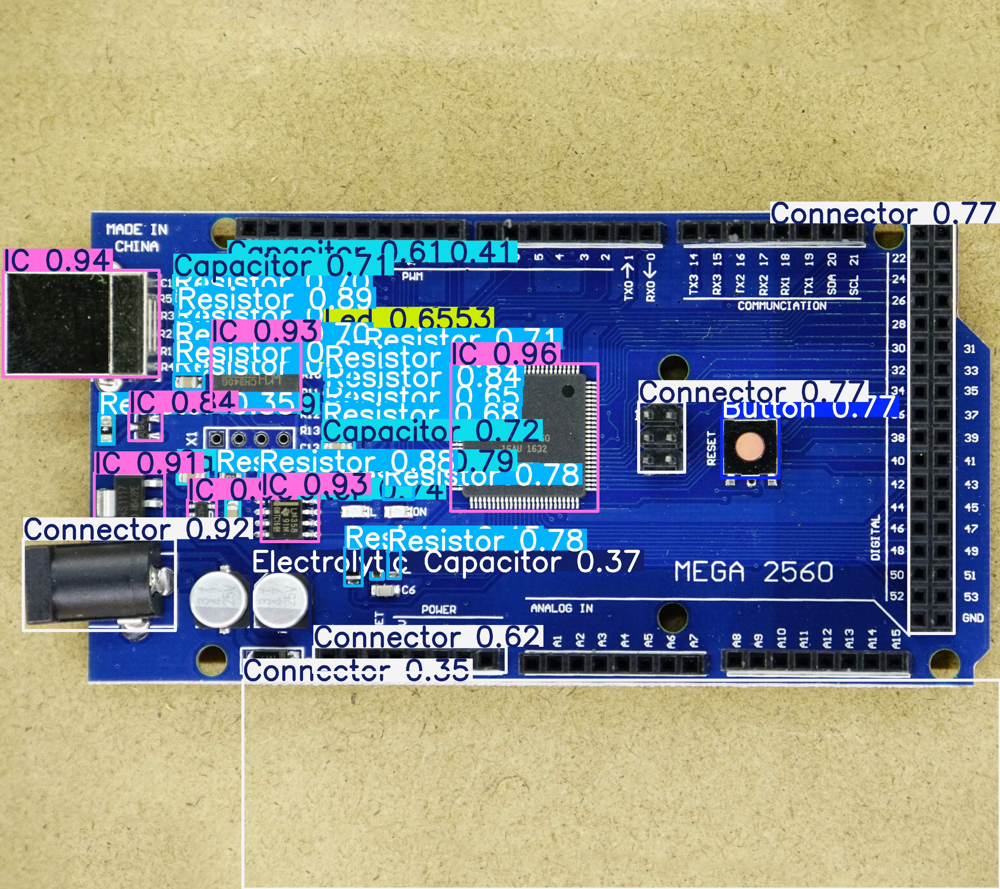


image 1/1 /content/drive/MyDrive/Project 3 Data/evaluation/arduno.jpg: 704x1024 11 Capacitors, 8 Connectors, 1 Diode, 2 Electrolytic Capacitors, 8 ICs, 3 Leds, 7 Resistors, 1 Transistor, 11.7ms
Speed: 4.4ms preprocess, 11.7ms inference, 1.4ms postprocess per image at shape (1, 3, 704, 1024)
Results saved to runs/detect/predict10


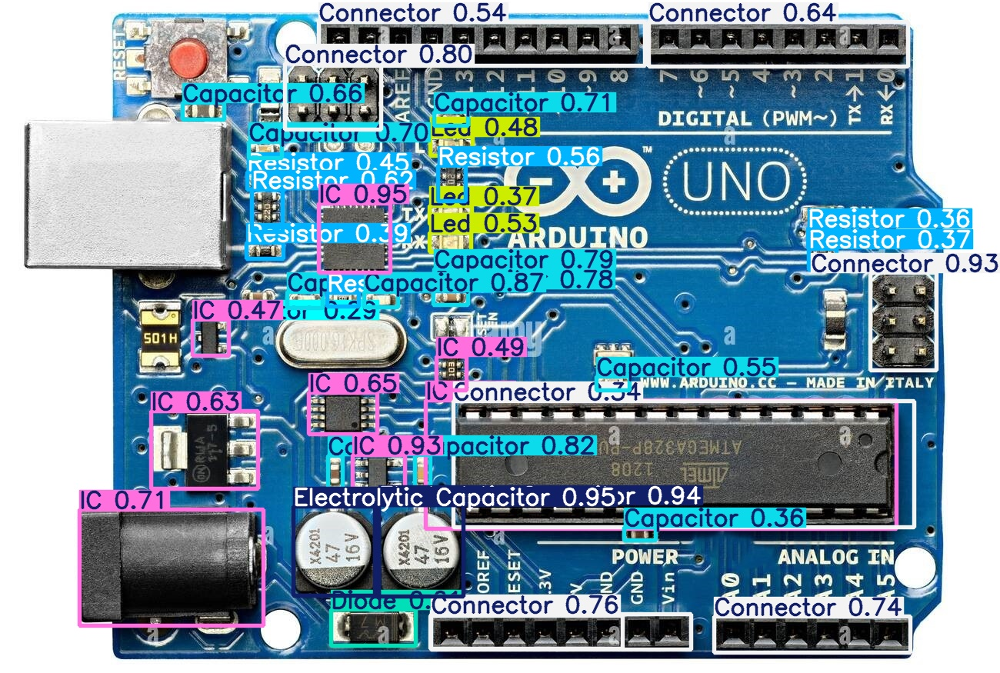


image 1/1 /content/drive/MyDrive/Project 3 Data/evaluation/rasppi.jpg: 704x1024 14 Capacitors, 9 Connectors, 1 Diode, 1 Electrolytic Capacitor, 10 ICs, 2 Leds, 2 Padss, 19 Resistors, 11.0ms
Speed: 6.1ms preprocess, 11.0ms inference, 1.7ms postprocess per image at shape (1, 3, 704, 1024)
Results saved to runs/detect/predict10


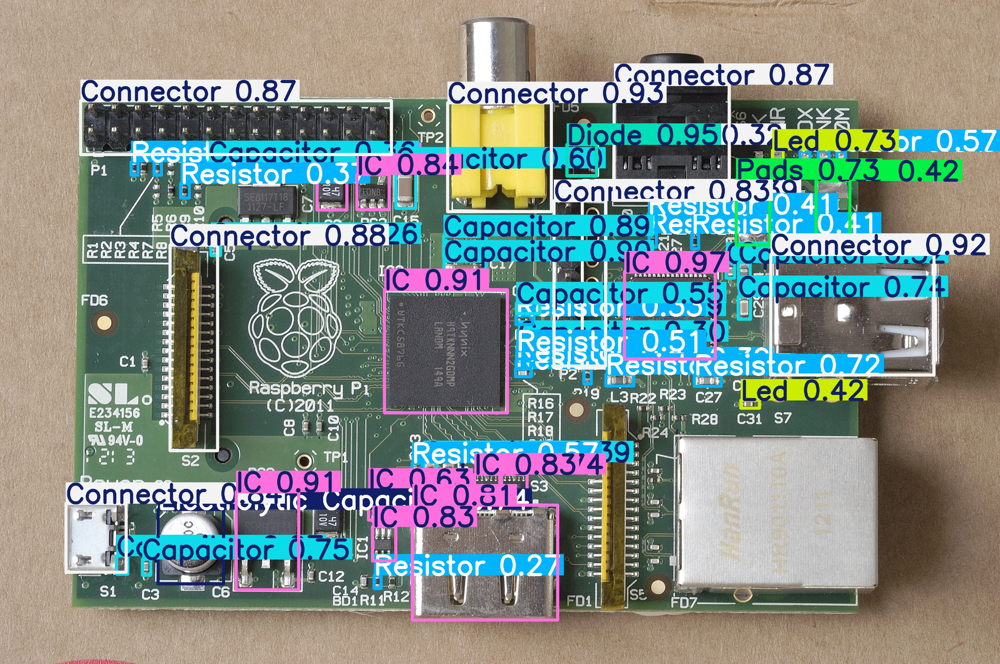

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

from ultralytics import YOLO
from IPython.display import Image, display
import os

# Path to your trained model weights
model_path = "/content/drive/MyDrive/Project 3 Data/runs/detect/pcb_detector_optimized_Final6/weights/best.pt"

# Paths to your evaluation images
evaluation_folder = "/content/drive/MyDrive/Project 3 Data/evaluation"
image_paths = [
    os.path.join(evaluation_folder, "ardmega.jpg"),
    os.path.join(evaluation_folder, "arduno.jpg"),
    os.path.join(evaluation_folder, "rasppi.jpg")
]

# Load the trained YOLO model
model = YOLO(model_path)

# Predict on each evaluation image and display results
for img_path in image_paths:
    # YOLO.predict() returns a list of result objects
    results = model.predict(source=img_path, save=True)

    # Get the save directory from the first result in the list
    save_dir = results[0].save_dir if results else "runs/detect/predict"
    predicted_image_path = os.path.join(save_dir, os.path.basename(img_path))

    # Display the predicted image
    display(Image(filename=predicted_image_path))


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).

image 1/1 /content/drive/MyDrive/Project 3 Data/evaluation/ardmega.jpg: 928x1024 1 Button, 6 Capacitors, 4 Connectors, 7 ICs, 3 Leds, 15 Resistors, 13.0ms
Speed: 7.4ms preprocess, 13.0ms inference, 1.4ms postprocess per image at shape (1, 3, 928, 1024)
Results saved to runs/detect/predict11


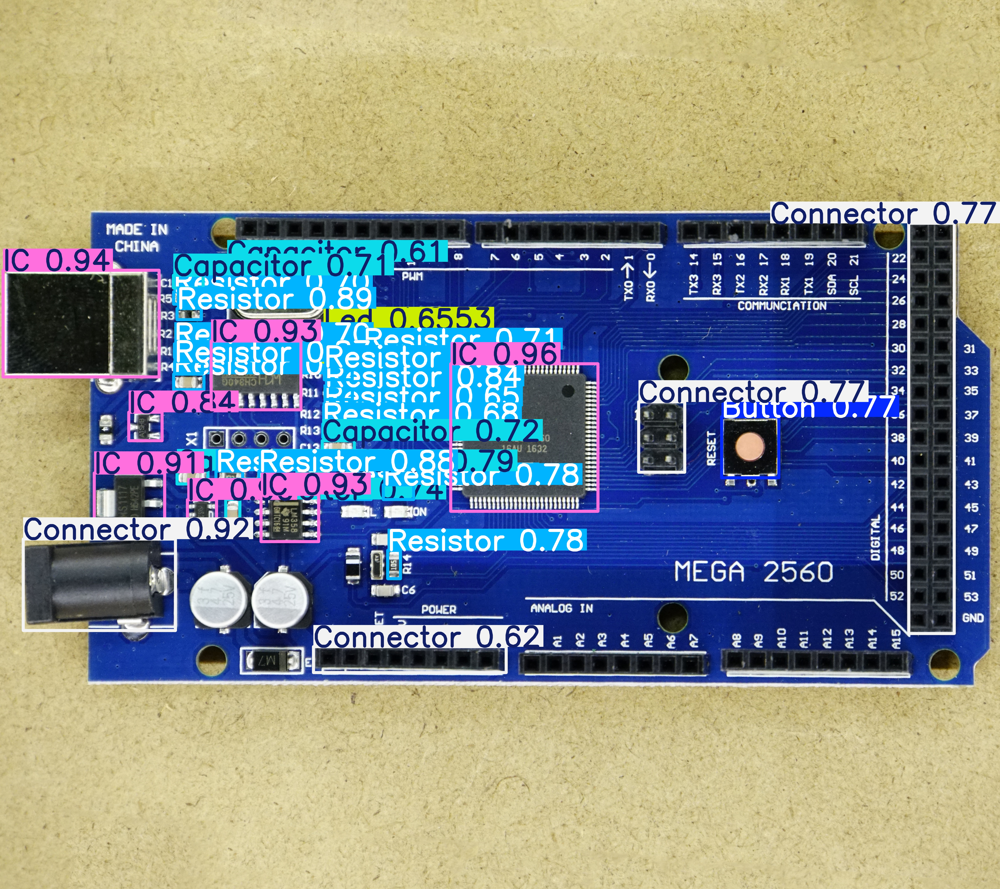


image 1/1 /content/drive/MyDrive/Project 3 Data/evaluation/arduno.jpg: 704x1024 10 Capacitors, 6 Connectors, 1 Diode, 2 Electrolytic Capacitors, 5 ICs, 1 Led, 3 Resistors, 11.6ms
Speed: 4.6ms preprocess, 11.6ms inference, 1.3ms postprocess per image at shape (1, 3, 704, 1024)
Results saved to runs/detect/predict11


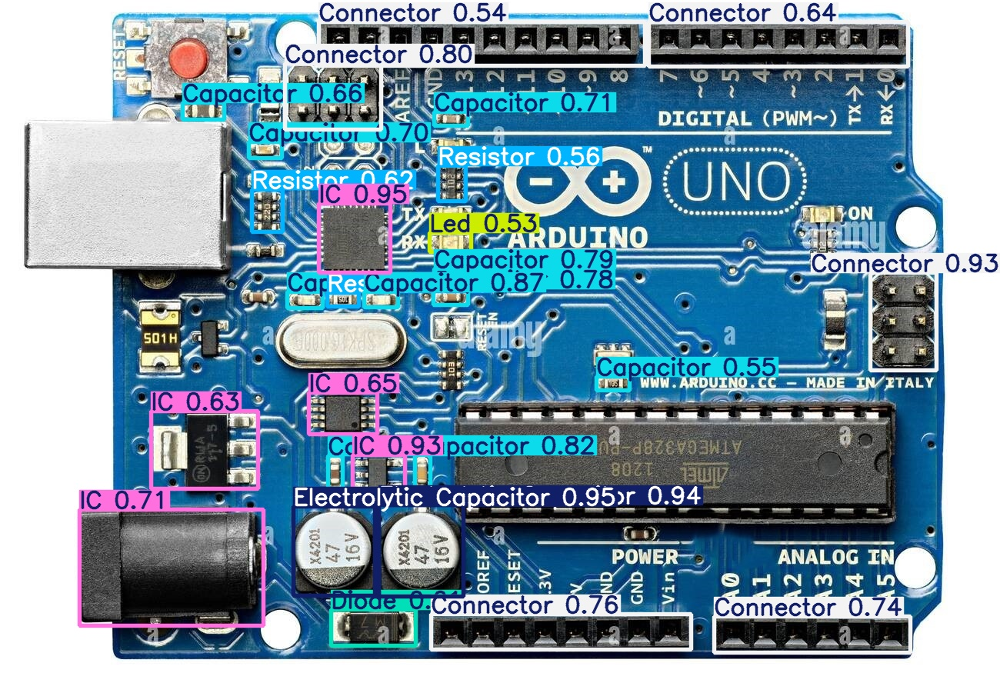


image 1/1 /content/drive/MyDrive/Project 3 Data/evaluation/rasppi.jpg: 704x1024 7 Capacitors, 7 Connectors, 1 Diode, 1 Electrolytic Capacitor, 9 ICs, 1 Led, 1 Pads, 5 Resistors, 11.0ms
Speed: 5.2ms preprocess, 11.0ms inference, 1.4ms postprocess per image at shape (1, 3, 704, 1024)
Results saved to runs/detect/predict11


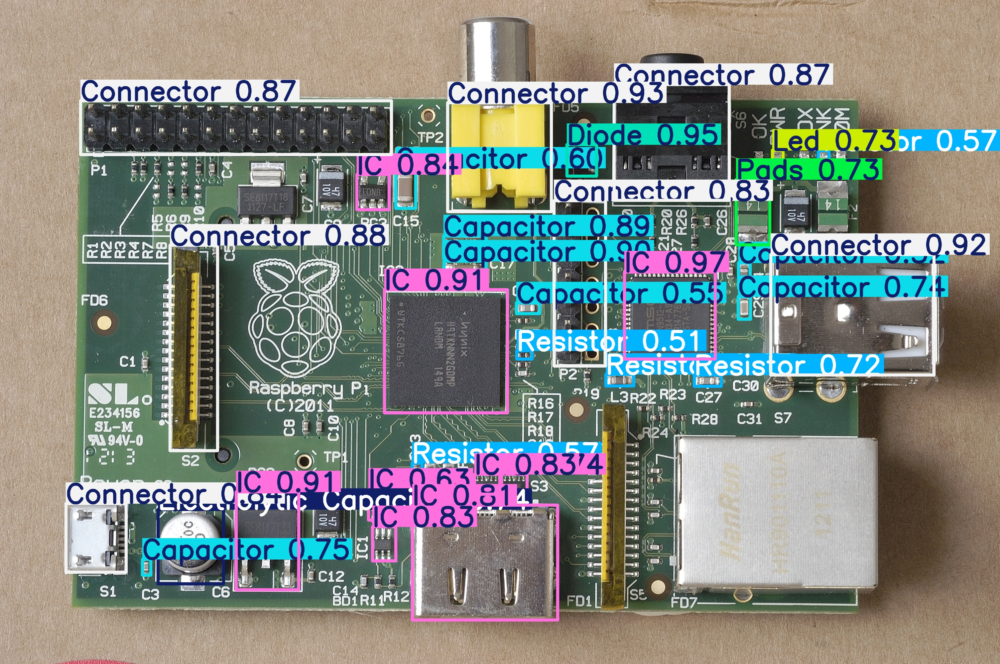

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

from ultralytics import YOLO
from IPython.display import Image, display
import os

# Path to your trained model weights
model_path = "/content/drive/MyDrive/Project 3 Data/runs/detect/pcb_detector_optimized_Final6/weights/best.pt"

# Paths to your evaluation images
evaluation_folder = "/content/drive/MyDrive/Project 3 Data/evaluation"
image_paths = [
    os.path.join(evaluation_folder, "ardmega.jpg"),
    os.path.join(evaluation_folder, "arduno.jpg"),
    os.path.join(evaluation_folder, "rasppi.jpg")
]

# Load the trained YOLO model
model = YOLO(model_path)

# Parameters to reduce clutter
confidence_threshold = 0.5  # Minimum confidence score to display a box
iou_threshold = 0.4         # Adjust IoU threshold for NMS

# Predict on each evaluation image
for img_path in image_paths:
    # YOLO.predict() with adjusted thresholds
    results = model.predict(source=img_path, conf=confidence_threshold, iou=iou_threshold, save=True)

    # The annotated images will be saved in a new runs/predict/ folder
    save_dir = results[0].save_dir if results else "runs/detect/predict"
    predicted_image_path = os.path.join(save_dir, os.path.basename(img_path))

    # Display the predicted image
    display(Image(filename=predicted_image_path))
